<a href="https://colab.research.google.com/github/chinmayAmbasht/phys-246-fa23/blob/main/FluidDynamics.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

<div><img src="https://clark.physics.illinois.edu/246img/FD_intro.png" width=1000  alt="Answer (start)"></img><br></div>


# Fluid Dynamics

* **Author:** Chinmay Ambasht

* **Date:** 10.26.2023

* **Time spent on this assignment:**

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import math
import numpy.linalg as la
from matplotlib.animation import FuncAnimation
import itertools
from copy import deepcopy
from IPython.display import HTML
import pickle
def resetMe(keepList=[]):
    ll=%who_ls
    keepList=keepList+['resetMe','np','plt','math','FuncAnimation',
                       'HTML','itertools','pickle','testFunc','la']
    for iiii in keepList:
        if iiii in ll:
            ll.remove(iiii)
    for iiii in ll:
        jjjj="^"+iiii+"$"
        %reset_selective -f {jjjj}
    ll=%who_ls
    return

def testFunc(func,inFiles,outFiles):
    inputs  = [pickle.load(open(f,"rb")) for f in inFiles]
    outputs = [pickle.load(open(f,"rb")) for f in outFiles]
    result  = func(*inputs)
    allGood = True
    if not isinstance(result, tuple): result = (result,)
    for i in range(len(outputs)):
        if np.max(np.abs(result[i]-outputs[i])) > 1e-14:
            print("Failed test for",outFiles[i],i,np.max(np.abs(result[i]-outputs[i])))
            allGood = False
    if allGood: print("Test Passed!")
    else:       print("Test Failed :(")

Download the test files here, or download from the website and upload & unzip them to wherever this notebook file is

In [ ]:
!wget https://courses.physics.illinois.edu/phys246/fa2020/code/TestFiles.zip && unzip TestFiles.zip

--2023-11-02 18:50:02--  https://courses.physics.illinois.edu/phys246/fa2020/code/TestFiles.zip
Resolving courses.physics.illinois.edu (courses.physics.illinois.edu)... 130.126.151.14
Connecting to courses.physics.illinois.edu (courses.physics.illinois.edu)|130.126.151.14|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 53041362 (51M) [application/x-zip-compressed]
Saving to: ‘TestFiles.zip’

TestFiles.zip       100%[===================>]  50.58M  6.02MB/s    in 8.0s    

2023-11-02 18:50:11 (6.36 MB/s) - ‘TestFiles.zip’ saved [53041362/53041362]

Archive:  TestFiles.zip
  inflating: Microscopic_after_move.dat  
  inflating: Microscopic.dat         
  inflating: rho_after_Micro2Macro.dat  
  inflating: Microscopic_after_bounce.dat  
  inflating: Microscopic2.dat        
  inflating: Microscopic_after_moveDensity.dat  
  inflating: Microscopic_after_boundary.dat  
  inflating: u_after_Micro2Macro.dat  
  inflating: Microscopic_after_collision.dat  
  inflating: 

## Python Warmup

### Useful functions:

Before we begin, we want to highlight some functions that you may find useful in this assignment. The last one we'll explore in more depth as well.
* `np.zeros([dimensions])` - create an array filled with all zeros.
    *Ex: `n = np.zeros([9,10,10])` creates a (9,10,10) array of all zeros
* `np.ones([dimensions])` - same thing as `np.zeros` but with all ones.
* `np.empty([dimensoons])` - same thing as `np,zeros` but fills array with garbage. Very fast compared to the above.
* `np.roll(x,shift,axis)` - shift array `x` by `shift` along `axis`.

### Warmup - using `np.roll`

Something we'll see later in this assignment is the need to shift elements right,left,up,down, and diagonally. Let's make a little test problem to illustrate how this works.

In [ ]:
# Run me!
x = np.arange(15).reshape(3,5)
print(x)

[[ 0  1  2  3  4]
 [ 5  6  7  8  9]
 [10 11 12 13 14]]


Now we'll want to shift every element in `x` to the right, where we wrap everything around the edge. Rather than figuring this out with a for loop, we'll employ `np.roll` to do it fast!

In [ ]:
print(x,'\n')
print(np.roll(x,(0,1),(0,1)))

[[ 0  1  2  3  4]
 [ 5  6  7  8  9]
 [10 11 12 13 14]] 

[[ 4  0  1  2  3]
 [ 9  5  6  7  8]
 [14 10 11 12 13]]


Now let's disect that command. The first `(0,1)` means don't shift the "y" direction, and to shift the "x" direction by +1. The next command `(0,1)` means to apply the shift to the two axes.  
Now let's go left:

In [ ]:
print(x,'\n')
print(np.roll(x,(0,-1),(0,1)))

[[ 0  1  2  3  4]
 [ 5  6  7  8  9]
 [10 11 12 13 14]] 

[[ 1  2  3  4  0]
 [ 6  7  8  9  5]
 [11 12 13 14 10]]


---
🦉 Now we'll try to implement a section of the Cha-Cha Slide([Lyrics](https://genius.com/Dj-casper-cha-cha-slide-lyrics))
```
♫Now it's time to get funky
To the right now, to the left
Take it back now y'all♪
```

Make your `x` array go right, then left, then "down". Your output should be:
```
[[ 4  0  1  2  3]
 [ 9  5  6  7  8]
 [14 10 11 12 13]]
[[ 1  2  3  4  0]
 [ 6  7  8  9  5]
 [11 12 13 14 10]]
[[ 5  6  7  8  9]
 [10 11 12 13 14]
 [ 0  1  2  3  4]]
```
(Notice how down isn't what you may expect...)

In [ ]:
#!Start
print(x)
print(np.roll(x,(0,1),(0,1)))
print(np.roll(x,(0,-1),(0,1)))
print(np.roll(x,(-1,0),(0,1)))
#!Stop

[[ 0  1  2  3  4]
 [ 5  6  7  8  9]
 [10 11 12 13 14]]
[[ 4  0  1  2  3]
 [ 9  5  6  7  8]
 [14 10 11 12 13]]
[[ 1  2  3  4  0]
 [ 6  7  8  9  5]
 [11 12 13 14 10]]
[[ 5  6  7  8  9]
 [10 11 12 13 14]
 [ 0  1  2  3  4]]


🦉In a special version of the song, the next line goes
```
♫ Take it diagonally up and to the right now y'all
```
Implement this array move, you should get:
```
[[14 10 11 12 13]
 [ 4  0  1  2  3]
 [ 9  5  6  7  8]]
 ```

In [ ]:
print(x)
print(np.roll(x,(1,1),(0,1))) #!#

[[ 0  1  2  3  4]
 [ 5  6  7  8  9]
 [10 11 12 13 14]]
[[14 10 11 12 13]
 [ 4  0  1  2  3]
 [ 9  5  6  7  8]]


Now you're a ~~Cha-Cha Slide~~ `np.roll` master!

## Exercise 1: Fluid Dynamics

* **List of collaborators:** James DiCarlo

* **References you used in developing your code:**

In this assignment you will produce a fluid dynamics simulations.  We are going to develop a number of functions which you will store in the cell below (as well as some global variables that we will use throughout this exercise).

The global variables are
```python
nx=520; ny=180 #size of our simulation
```


<div><img src="https://clark.physics.illinois.edu/246img/AnsStart.svg" width=200 align=left alt="Answer (start)"></img><br></div>

In [ ]:
### ANSWER HERE
nx = 520
ny = 180

<div><img src="https://clark.physics.illinois.edu/246img/AnsEnd.svg" width=200 align=left alt="Answer (end)"></img><br></div>

<div class="alert alert-danger" style="color:black">

If you have a function that takes in an array <code>n</code>, always make a new variable to return:
```python
def doMath(n):
    # nout = n.copy() #notice the .copy(), so that they aren't the same object
    nout = 2*n+5
    return nout
```

</div>

### a.  Making some obstacles

To simulate the real world on the computer, we'll break the tunnel into $n_x\times n_y$ squares which we'll call *voxels*.  


Your simulation will be doing fluid dynamics in a $n_x \times n_y$ "tunnel" which has some objects within it.  These objects will be represented by a boolean $n_x \times n_y$ size array `obstacle=np.empty((nx,ny),dtype='bool')` which should be `True` where the obstacle is and `False` otherwise. For example,
```python
obstacle[:,:]=False
obstacle[50:70,50:70]=True
```
would set up a square $20 \times 20$ object inside our tunnel.

🦉Add a `GenerateCylinderObstacle()`  function to the "function-cell" above which generates a object which is a cylinder located at $(n_x/4,n_y/2)$ with a radius of $n_y/9$

If you do `plt.matshow(GenerateCylinderObstacle())` it should look like this

<div><img src="https://clark.physics.illinois.edu/246img/FDObstacle.png" width=600 alt="Answer (start)"></img><br></div>

<div class="alert alert-warning" style="color:black">
<b>Do not use the word <code>object</code> as a variable!</b> <br />Notice how <code>object</code> is green in a cell - this means it is a special keyword.<br />
</div>

In [ ]:
def GenerateCylinderObstacle():
  r = ny / 9
  obstacle = np.zeros((nx,ny), dtype = 'bool')
  pos = np.argwhere(obstacle == False)
  dist_center = np.sqrt((pos[:,0] - (nx / 4))**2 + (pos[:,1] - (ny / 2))**2).reshape(nx,ny)
  obstacle[dist_center < r] = True
  return obstacle
obstacle = GenerateCylinderObstacle()

#### Test:

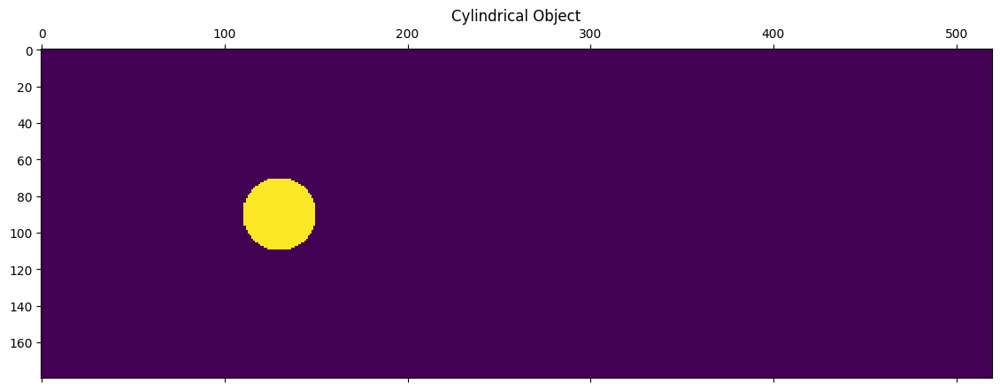

In [ ]:
## Call your function here to see if if works.
plt.matshow(GenerateCylinderObstacle().transpose())
plt.title("Cylindrical Object")
plt.savefig("imagesobject.png")
plt.show()


## b.  Microscopic velocities $v_i$

To simulate the real world on the computer, we'll break the tunnel into $n_x\times n_y$ squares which we'll call *voxels*.

The key quantity in your simulation is  nine microscopic degrees of freedom
* $n_k(i,j)$ where $0\leq k \leq 8$ and $(i,j)$ are over the $n_x \times n_y$ voxels of your simulation

which are going to be nine different densities (for each voxel $(i,j)$) which correspond to the density of a fluid at $(i,j)$ moving in nine different directions (or velocities $v_k$):
* $n_0$: stationary fluid moving at velocity $v_0=(0,0)$
* $n_1$: fluid moving up moving at velocity $v_1=(0,1)$
* $n_2$: fluid moving down at velocity $v_2=(0,-1)$
* $n_3$: fluid moving right at velocity $v_3=(1,0)$
* $n_4$: fluid moving left at velocity $v_4=(-1,0)$
* $n_5$: fluid moving left-down at velocity $v_5=(-1,-1)$
* $n_6$: fluid moving left-up at velocity $v_6=(-1,1)$
* $n_7$: fluid moving right-down at velocity $v_7=(1,-1)$
* $n_8$: fluid moving right-up at velocity $v_8=(1,1)$
    
It will be useful to have access to these microscopic velocities as global variables.  🦉**Go ahead and add to the top of your "function-cell" the various velocities:**
```python
v=np.zeros((9,2),dtype='int')
v[0,:]=[0,0]
v[1,:]=[0,1]
...
```

**Plot these (below) as**
```python
for i in range(0,9):
    plt.arrow(0,0,v[i,0],v[i,1],head_width=0.05, head_length=0.1, fc='k', ec='k')
plt.xlim(-1.2,1.2)
plt.ylim(-1.2,1.2)
plt.show()
```
and make sure it looks like
<div><img src="https://clark.physics.illinois.edu/246img/FD_direction.png" width=300 alt="Answer (start)"></img><br></div>


In [ ]:
# ANSWER ME
def MicroscopicVelocitiesSetup():
  # v = np.zeros((9, 2), dtype = 'int')
  v = np.zeros((9, 2),  dtype = 'int')
  v[0, :] = [0, 0]
  v[1, :] = [0, 1]
  v[2, :] = [0, -1]
  v[3, :] = [1, 0]
  v[4, :] = [-1, 0]
  v[5, :] = [-1, -1]
  v[6, :] = [-1, 1]
  v[7, :] = [1, -1]
  v[8, :] = [1, 1]
  # v[:, 1] = [0, 1, -1, 0, 0, -1, 1, -1, 1]
  # v[:, 0] = [0, 0, 0, 1, -1, -1, -1, 1, 1]
  return v
v = MicroscopicVelocitiesSetup()

#### Test:

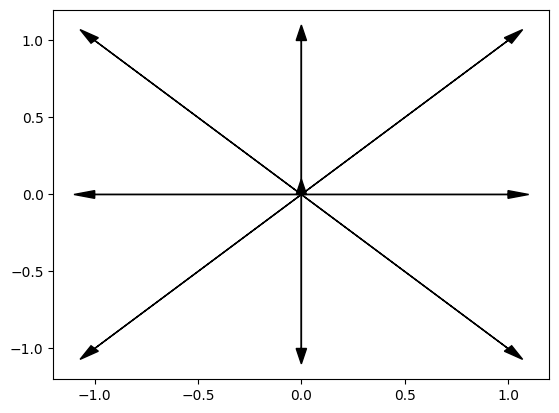

In [ ]:
## Plot your microscopic velocities
v = MicroscopicVelocitiesSetup()
for i in range(0,9):
    plt.arrow(0,0,v[i,0],v[i,1],head_width=0.05, head_length=0.1, fc='k', ec='k')
plt.xlim(-1.2,1.2)
plt.ylim(-1.2,1.2)
#plt.savefig("images/densityDirection.png")
plt.show()

We will represent the microscopic densities by a variable
* `n=np.zeros(9,nx,ny)`


The high level algorithm for fluid dynamics is very simple.  After setting up the initial conditions, we loop many times doing
* Adjust boundary conditions
* Collide the microscopic densities
* Move the microscopic densities


### c. Computing macroscopic quantities from the microscopic density

Given the microscopic densities, there are two macroscopic quanties:
* the macroscopic density $\rho(i,j)=\sum_k n_k$ (*size: $n_x \times n_y$*)
* the macroscopic velocity $\vec{u}(i,j) \equiv (u_x(i,j),u_y(i,j)$ (*size: $2 \times n_x \times n_y$*) where
    * $u_x(i,j) = 1/\rho \sum_k v_{k,x}\, n_k(i,j)$
    * $u_y(i,j) = 1/\rho \sum_k v_{k,y}\, n_k(i,J)$

which you will compute using the function (you will write) `(rho,u) = Micro2Macro(n)`

🦉Go ahead and write this function and add it to your 'function-cell'

You can test it using these lines of code:
```python
testFunc(Micro2Macro,["Microscopic.dat"],["rho_after_Micro2Macro.dat","u_after_Micro2Macro.dat"])
```
and see if it print two zeros (which is a success!)

**Tip:** Because `u` is $(2,n_x,n_y)$, we can get `ux` by doing `u[0]` (which is then a $(n_x,n_y)$ array) and `uy` by doing `u[1]`.

#### optional - `np.einsum`

Figuring out the summations effeciently can be a pain, but we can use [`np.einsum`](https://docs.scipy.org/doc/numpy/reference/generated/numpy.einsum.html) help out here. Figure out how to rewrite the above problem with einstein summation notation. To use the function, if we have
$$
A_{ijk}\cdot B_{dk} = C_{ijd},
$$
we'd use then call:
```python
C = np.einsum("ijk,dk->ijd",A,B)
```

In [ ]:
# ANSWER ME
#n = np.zeros((9, nx, ny))
def Micro2Macro(n):
  rho = np.sum(n , axis = 0)
  v = MicroscopicVelocitiesSetup()
  u = (1 / rho) * np.einsum("km, kxy -> mxy", v, n)
  return (rho, u)


#### Test:

In [ ]:
#!Start
# import pickle
# np.random.seed(30)
# microscopicDensity=np.random.random((9,nx,ny))
# pickle.dump( microscopicDensity, open( "Microscopic.dat", "wb" ) )
# (rho,u)=Micro2Macro(microscopicDensity)
# pickle.dump( rho, open( "rho_after_Micro2Macro.dat", "wb" ) )
# pickle.dump( u, open( "u_after_Micro2Macro.dat", "wb" ) )
#!Stop
testFunc(Micro2Macro,["Microscopic.dat"],["rho_after_Micro2Macro.dat","u_after_Micro2Macro.dat"])

Test Passed!


### d. Getting the equilibrium microscopic densities.


Given the macroscopic densities $\rho$ and $\vec{u}$, there is a *equilibrium* microscopic densities $n_{eq}$ (*size: $9 \times n_x \times n_y$*) which you will compute using `n_eq=Macro2Equilibrium(rho,u,obstacle)`

The relevant formula for this is

$$ n^{eq}(v_k) \equiv n_k^{eq} =  \omega_k \rho \left(1 + 3 \vec{v_k} \cdot \vec{u} + \frac{9}{2}(\vec{v_k} \cdot \vec{u})^2- \frac{3}{2}(\vec{u}\cdot \vec{u}) \right)  \tag{A} $$

where
* $\omega_{0}=4/9$
* $\omega_{1-4}=1/9$
* $\omega_{5-8}=1/36$

Given some microscopic densities $n$ you should be able then to figure out the equilibrium microscopic densities $n_{eq}$.  

🦉Write the functions `Macro2Equilibrium` adding them to your "function-cell"

You can test it by checking if
```python
testFunc(Macro2Equilibrium,["rho_after_Micro2Macro.dat","u_after_Micro2Macro.dat"],["Microscopic_after_equilibrium.dat"])
```
is equal to zero.

In [ ]:
# ANSWER ME
def Macro2Equilibrium(rho, u):
  v = MicroscopicVelocitiesSetup()
  omega = np.array([4/9 , 1/9, 1/9, 1/9, 1/9, 1/36, 1/36, 1/36, 1/36])
  A =  np.einsum('ka, axy -> kxy', v, u)
  B =  np.einsum('abc, abc -> bc', u, u)
  C = A ** 2
  vEqSquare = rho * (1 + 3 * A + 4.5 * C - 1.5 * B)
  neq =  np.einsum("k, kxy -> kxy", omega, vEqSquare)
  return neq

#### Test:

In [ ]:
#pickle.dump( microscopicDensity, open( "Microscopic_after_equilibrium.dat", "wb" ) ) #!#
testFunc(Macro2Equilibrium,["rho_after_Micro2Macro.dat","u_after_Micro2Macro.dat"],["Microscopic_after_equilibrium.dat"] )


Test Passed!


### d. Implementing collision

Once you can compute these quantities, the next step is to implement the collision step.  

🦉Write a function `Collision(n,obstacle)` which returns the density `n` after collision.  Put it in your function-cell above.


When we collide the microscopic densities, we get new microscopic densities given as  
* `nout = n * (1-omega) + omega * neq`

Here are the steps for the function:
1. Calculate `neq`  
    a. take the microscopic densities $\rightarrow$ compute the macroscopic density and velocity `(rho,u) = Micro2Macro(n)`  
    b. take the macroscopic density and velocity $\rightarrow$ compute the equilibrium microscopic densities `neq=Macro2Equilibrium(rho,u)`  
2. Calculate `nout = n * (1-omega) + omega * neq`   
    a. $\omega$ is the viscosity parameter.  We will use $\omega =1.9572953736654806$
3. We moved fluid where the obstacle is, so we need to undo this. Reset all `nout` where the obstacle is to be the same as `n`



Test with
```python
testFunc(lambda x: Collision(x,GenerateCylinderObstacle()),["Microscopic.dat"],["Microscopic_after_collision.dat"])
```


In [ ]:
# ANSWER ME
def Collision (n, obstacle):
  omega = 1.9572953736654806
  (rho, u) = Micro2Macro(n)
  neq = Macro2Equilibrium(rho, u)
  nout = n * (1 - omega) + omega * neq
  # Try 1
  # nout [obstacle.any() == True] = n

  # Try 2
  # obstacleIndex = np.argwhere(obstacle == True)
  # nout[:, obstacleIndex[:,0], obstacleIndex[1,:]] = n[:, obstacleIndex[0,:], obstacleIndex[1,:]]
  nout[:, obstacle] = n[:, obstacle]
  # for k in range(0, 9):
  #   nout[k][obstacle] = n[k][obstacle]
  return nout

#### Test:

In [ ]:
#pickle.dump( Collision(microscopicDensity,GenerateCylinderObstacle()), open( "Microscopic_after_collision.dat", "wb" ) ) #!#
testFunc(lambda x: Collision(x,GenerateCylinderObstacle()),["Microscopic.dat"],["Microscopic_after_collision.dat"])

Test Passed!


### e. Moving

We'll now move on to getting the fluid to move. This will be a function called, surprise, `Move(n,obstacle)`. But first we need to helper functions:
* `Bounce(n,obstacle)`
    * bounce the velocities - that is every velocity where the obstacle is gets reversed
* `MoveDensity(n)`
    * Move all your densities in the direction of the velocity (*hint* the velocity tells you where to move it)
    * Assume periodic boundary conditions here

Thus a `Move(n,obstacle)` call is just a `Bounce` then `MoveDensity`. 🦉Write this function and test!


Test:
```python
testFunc(lambda x: Bounce(x,GenerateCylinderObstacle()),["Microscopic.dat"],["Microscopic_after_bounce.dat"])

testFunc(MoveDensity,["Microscopic.dat"],["Microscopic_after_moveDensity.dat"])

testFunc(lambda x: Move(x,GenerateCylinderObstacle()),["Microscopic.dat"],["Microscopic_after_move.dat"])
```

In [ ]:
# ANSWER ME
def Bounce(n, obstacle):
  # targetIndices = np.array([[0, 0], [1, 2], [2, 1], [3, 4], [4,3]\
  #                           ,[5, 8], [6, 7], [7, 6], [8, 5]])
  # originalIndices = np.arange(0, 9)
  # targetIndices = np.array([0, 2, 1, 4, 3, 8, 7, 6, 5])
  # newN = n.copy()
  # newN[originalIndices, :, :] = n[targetIndices, :, :]
  #obstacle = GenerateCylinderObstacle()
  newN = deepcopy(n)
  swap = [0, 2, 1, 4, 3, 8, 7, 6, 5]
  for k in range(9):
    newN[k][obstacle] = n[swap[k]][obstacle]
  return newN

def MoveDensity(n):
  # newN = np.copy(n)
  # # * $n_1$: fluid moving up moving at velocity $v_1=(0,1)$
  # newN[1] = np.roll(newN[1], (0, 1), axis = (0, 1))
  # # * $n_2$: fluid moving down at velocity $v_2=(0,-1)$
  # newN[2] = np.roll(newN[2], (0, -1), axis = (0, 1))
  # # * $n_3$: fluid moving right at velocity $v_3=(1,0)$
  # newN[3] = np.roll(newN[3], (1, 0), axis = (0, 1))
  # # * $n_4$: fluid moving left at velocity $v_4=(-1,0)$
  # newN[4] = np.roll(newN[4], (-1, 0), axis = (0, 1))
  # # * $n_5$: fluid moving left-down at velocity $v_5=(-1,-1)$
  # newN[5] = np.roll(newN[5], (-1, -1), axis = (0, 1))
  # # * $n_6$: fluid moving left-up at velocity $v_6=(-1,1)$
  # newN[6] = np.roll(newN[6], (-1, 1), axis = (0, 1))
  # # * $n_7$: fluid moving right-down at velocity $v_7=(1,-1)$
  # newN[7] = np.roll(newN[7], (1, -1), axis = (0, 1))
  # # * $n_8$: fluid moving right-up at velocity $v_8=(1,1)$
  # newN[8] = np.roll(newN[8], (1, 1), axis = (0, 1))
  newN = n.copy()
  for k in range(9):
    newN[k] = np.roll(newN[k], v[k], (0, 1))
  return newN

def Move(n, obstacle):
  newBounce = Bounce(n, obstacle)
  newDensity = MoveDensity(newBounce)
  return newDensity

#### Tests:

In [ ]:
#!Start
#pickle.dump( MoveDensity(microscopicDensity), open( "Microscopic_after_moveDensity.dat", "wb" ) )
##pickle.dump( MoveDensity(microscopicDensity,GenerateCylinderObstacle()), open( "Microscopic_after_collision.dat", "wb" ) )
##print(np.max(np.abs(Collision(microscopicDensity,GenerateCylinderObstacle())-pickle.load( open( "Microscopic_after_collision.dat", "rb" ) ))))
#microscopicDensity=pickle.load( open( "Microscopic.dat", "rb" ) )
#pickle.dump( Bounce(microscopicDensity,GenerateCylinderObstacle()), open( "Microscopic_after_bounce.dat", "wb" ))
#microscopicDensity=pickle.load( open( "Microscopic.dat", "rb" ) )
#pickle.dump( Move(microscopicDensity,GenerateCylinderObstacle()), open( "Microscopic_after_move.dat", "wb" ) )
#!Stop

testFunc(lambda x: Bounce(x,GenerateCylinderObstacle()),["Microscopic.dat"],["Microscopic_after_bounce.dat"])

Test Passed!


In [ ]:
testFunc(MoveDensity,["Microscopic.dat"],["Microscopic_after_moveDensity.dat"])

Test Passed!


In [ ]:
testFunc(lambda x: Move(x,GenerateCylinderObstacle()),["Microscopic.dat"],["Microscopic_after_move.dat"])

Test Passed!


### f.  Boundary conditions

In the y-direction, we are just going to assume that the boundary conditions are periodic. For the x-direction, we are going to assign certain boundary conditions on the left and right.  

Let's call this function `FixBoundary(n,n_init)` which applies these boundary conditions and returns the new density `n`.

**Left:** we are going to assume that there is a flow - this means that the microscopic densities are the same at each step.  Therefore, what we should do is simply replace the current densities on the left-most row with the initial microscopic densities (`n_init`).

**Right:** we are going to assume that the gradient is zero - i.e. the important physics has dissapeared by this point.  To do this, we will set

```python
# loop over all microscopic velocities vL that are going left
   nout[vL,-1,:] = nout[vL,-2,:]
```
*Hint:* there are 3 `vL`s.


🦉Put all of this together and run the next test!

Testing:
```python
testFunc(FixBoundary,["Microscopic.dat","Microscopic2.dat"], ["Microscopic_after_boundary.dat"])
```


In [ ]:
# ANSWER ME
def FixBoundary(n, n_init):
  nout  = deepcopy(n)
  # LEFT
  nout[:,0,:] = n_init[:,0,:]
  # RIGHT
  vL = [4, 5, 6]
  nout[vL,-1,:] = nout[vL,-2,:]
  return nout

#### Test:

In [ ]:
#!Start
#microscopicDensity2=np.random.random((9,nx,ny))
#pickle.dump(microscopicDensity2,open( "Microscopic2.dat","wb"))
#pickle.dump( FixBoundary(microscopicDensity,microscopicDensity2), open( "Microscopic_after_boundary.dat", "wb" ) )
#!Stop
testFunc(FixBoundary,["Microscopic.dat","Microscopic2.dat"], ["Microscopic_after_boundary.dat"])

Test Passed!


### g. Setting up the initial conditions

We need to generate an initial conditions. The way that we are going to do that is
* pick some macroscopic density $\rho$ of size $(n_x,n_y)$ (uniformly equal to 1.0) and a
* macroscopic velocity $\vec{u}(i,j)$ (sizes $(2,n_x,n_y)$)
    *  zero in the x-direction (aka 0)
    * `0.04*(1.0+1e-4*np.sin(y/(ny)*2*np.pi))` in the y-direction (aka 1). This introduces a very tiny anisotropy to the system.
* compute the equilibrium density $n_{eq}$ associated with the initial density and velocities.   
**Use (and return) this as the initial conditions**

🦉Write a function `Setup()` which returns the initial microscopic densities.  Remember to save this as you will need it to apply your boundary conditions.

I get the following when I visualize it as `plt.matshow(Setup()[3].transpose())`

<div><img src="https://clark.physics.illinois.edu/246img/FD_initialCondition.png" width=800  alt="Answer (start)"></img><br></div>

A quick test here is just to check that the following:
```python
print("All good?",(np.abs(np.max(Setup())-0.443377991)<1e-5) and ((np.abs(np.min(Setup())-0.0245774711)<1e-5)))
```

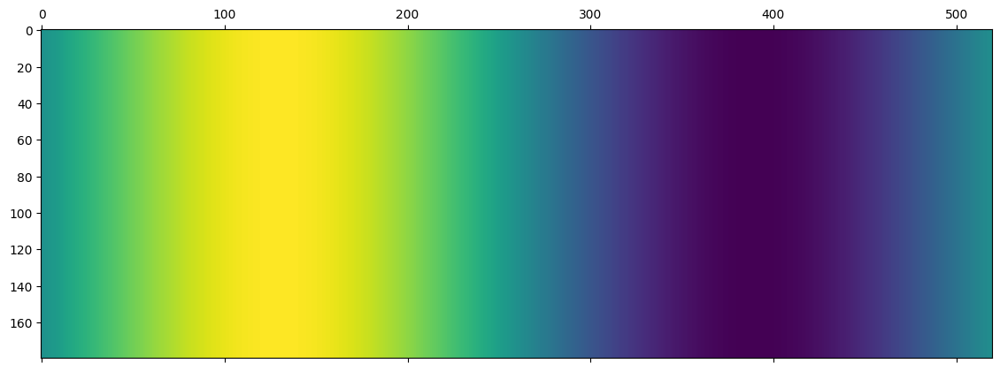

In [ ]:
#ANSWER ME
def Setup():
  rhoInitial = np.ones((nx, ny))
  u = np.zeros((2, nx, ny))
  y = np.arange(0, nx)
  ux = 0.04*(1.0+1e-4*np.sin(y/(nx)*2*np.pi))
  u[0, :, :] = ux[np.newaxis, :, np.newaxis]
  neq = Macro2Equilibrium(rhoInitial, u)
  return neq
plt.matshow(Setup()[3].T)

n_init = Setup()


#### Test:

In [ ]:
print("All good?",(np.abs(np.max(Setup())-0.443377991)<1e-5) and ((np.abs(np.min(Setup())-0.0245774711)<1e-5)))

All good? True


### h. Putting it all together

🦉Write a function `Run(steps,record,n,n_init,obstacle)` (up in your function-cell) which takes
* the number of steps `steps` you want to run
* how often you want to `record` the velocity and density
* the microscopic densities `n` to start running from
* as well as the initial microscopic densities `n_init` for the boundary conditions (often equal to `n.copy()`)
* and the obstacle boolean array.

Each step consists of:
1. Adjust boundary conditions
2. Collide the microscopic densities
3. Move the microscopic densities

It should return
* a list of macroscopic densities `rhos`
* a list of macroscopic velocities `us`
    * This will be `u2=`$\sqrt{\vec{u}\cdot\vec{u}}$
    * To help us later, store these as `u2.transpose()`
* the last microscopic density `n`

Now (below) call your `Setup` and `Run` functions. Then plot the final configuration (something like `plt.matshow(us[-1])`).  

🦉Run for 201 steps recording every 100 steps.

#### Answer:

In [ ]:

def Run(steps, record, n, n_init, obstacle):
  rhos = []
  us = []
  nout = n.copy()
  for step in range(steps):
    nout = FixBoundary(nout, n_init)
    nout = Collision(nout, obstacle)
    nout = Move(nout, obstacle)
    if step % record == 0:
      (rho, u) = Micro2Macro(nout)
      rhos.append(rho)
      u2 = np.einsum("abc, abc -> bc", u, u)
      us.append(u2.transpose())
  return rhos, us, nout

In [ ]:
#fin = pickle.load(open('setup.pickle','rb'))

In [ ]:
#!Start
fin=Setup()
feq_init=fin.copy()
obstacle=GenerateCylinderObstacle()
#!Stop

In [ ]:
#!Start
fins=rhos=us= [None] * 21
fins[0]=fin.copy()
for i in range(0, 20):
    print(i)
    %time (rhos[i] ,us[i], fins[i+1]) = Run(2000, 100, fins[i], feq_init,obstacle)
#!Stop

0
CPU times: user 56.9 s, sys: 188 ms, total: 57.1 s
Wall time: 57.3 s
1
CPU times: user 57.1 s, sys: 211 ms, total: 57.3 s
Wall time: 57.7 s
2
CPU times: user 57.6 s, sys: 212 ms, total: 57.8 s
Wall time: 58 s
3
CPU times: user 57.8 s, sys: 177 ms, total: 58 s
Wall time: 58.7 s
4
CPU times: user 57.5 s, sys: 201 ms, total: 57.7 s
Wall time: 58 s
5
CPU times: user 55.7 s, sys: 183 ms, total: 55.9 s
Wall time: 56.2 s
6
CPU times: user 55.9 s, sys: 194 ms, total: 56.1 s
Wall time: 56.3 s
7
CPU times: user 55 s, sys: 189 ms, total: 55.2 s
Wall time: 55.4 s
8
CPU times: user 55.4 s, sys: 206 ms, total: 55.6 s
Wall time: 55.8 s
9
CPU times: user 55.5 s, sys: 203 ms, total: 55.7 s
Wall time: 56 s
10
CPU times: user 54.8 s, sys: 209 ms, total: 55 s
Wall time: 55.2 s
11
CPU times: user 55.2 s, sys: 156 ms, total: 55.4 s
Wall time: 55.5 s
12
CPU times: user 56.3 s, sys: 170 ms, total: 56.5 s
Wall time: 56.7 s
13
CPU times: user 56.7 s, sys: 174 ms, total: 56.9 s
Wall time: 57 s
14
CPU times: us

### i. Animation

🦉Now write a function `AnimateMe(us_flat,vMax)` which is going to take a list of velocities `us_flat` (and maximum for the `vMax`) and going to return an animation which is going to be then produced by calling
```python
anim = AnimateMe(us,vMax)
HTML(anim.to_jshtml())
```

This function will look like:
```python
def AnimateMe(us_flat,vMax):
    fig, ax = plt.subplots()
    cax = ax.imshow(us_flat[1],cmap=plt.cm.Reds,vmin=0,vmax=vMax)
    plt.close(fig)
    def animate(i):
         cax.set_array(us_flat[i])

    anim = FuncAnimation(fig, animate, interval=100, frames=len(us_flat))
    return anim
```



#### Answer:

In [ ]:
def AnimateMe(us_flat,vMax):
    fig, ax = plt.subplots()
    cax = ax.imshow(us_flat[1],cmap=plt.cm.Reds,vmin=0,vmax=vMax)
    plt.close(fig)
    def animate(i):
         cax.set_array(us_flat[i])

    anim = FuncAnimation(fig, animate, interval=100, frames=len(us_flat))
    return anim

In [ ]:
#!Start
us_flat = list(itertools.chain.from_iterable(us[0:-1]))
#us_flat = list(itertools.chain.from_iterable(us[0:17]))
anim=AnimateMe(us_flat,0.01)
fluidSimulation = HTML(anim.to_jshtml())
with open('fluid_sim_cylindrical_object.html','w') as f:
  f.write(fluidSimulation.data)
fluidSimulation

#!Stop

### j. Speed Test (EC)
*5 Points*

Our code for for `%time Run(2000,3000,Setup(),Setup(),GenerateCylinderObstacle())` takes between 45 and 60 seconds. We'll give 5 points if you can make your code faster than 40 seconds runtime (on the server). Warning: we aren't sure this is possible!

#### Answer:

In [ ]:
%time Run(2000,3000,Setup(),Setup(),GenerateCylinderObstacle())

CPU times: user 56.2 s, sys: 202 ms, total: 56.4 s
Wall time: 56.7 s


([array([[0.99999994, 0.99999994, 0.99999994, ..., 0.99999994, 0.99999994,
          0.99999994],
         [0.99999995, 0.99999995, 0.99999995, ..., 0.99999995, 0.99999995,
          0.99999995],
         [0.99999995, 0.99999995, 0.99999995, ..., 0.99999995, 0.99999995,
          0.99999995],
         ...,
         [0.99999995, 0.99999995, 0.99999995, ..., 0.99999995, 0.99999995,
          0.99999995],
         [0.99999996, 0.99999996, 0.99999996, ..., 0.99999996, 0.99999996,
          0.99999996],
         [0.99999998, 0.99999998, 0.99999998, ..., 0.99999998, 0.99999998,
          0.99999998]])],
 [array([[0.0016    , 0.0016    , 0.00160001, ..., 0.00159999, 0.00159999,
          0.0016    ],
         [0.0016    , 0.0016    , 0.00160001, ..., 0.00159999, 0.00159999,
          0.0016    ],
         [0.0016    , 0.0016    , 0.00160001, ..., 0.00159999, 0.00159999,
          0.0016    ],
         ...,
         [0.0016    , 0.0016    , 0.00160001, ..., 0.00159999, 0.00159999,
          0.

## Exercise 2: Walls

* **List of collaborators:**

* **References you used in developing your code:**

In this exercise we are going to use all the same code but generate a different object.  Here generate an object which consists of two walls:
* one spans $50 \leq x \leq 60$ and $n_y/4 \leq y \leq 3n_y/4$
* the other spans $200 \leq x \leq 210$ and $n_y/4 \leq y \leq 3n_y/4$

🦉Run your code again with this new obstacle and generate a new animation.

#### Answer:

In [ ]:
nx, ny = 520, 180

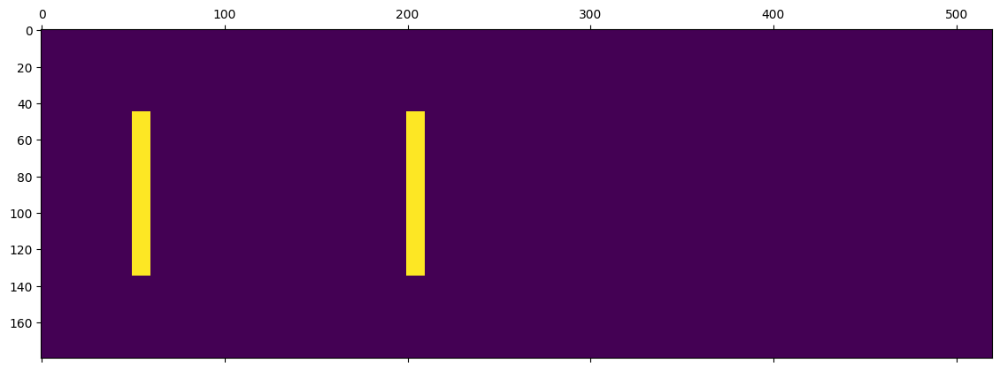

In [ ]:
def GenerateWallObstacle():
  obstacle = np.zeros((nx,ny), dtype = 'bool')
  obstacle[:,:] = False
  obstacle[50: 60, int(0.25 * ny): int(0.75 * ny)] = True
  obstacle[200: 210, int(0.25 * ny): int(0.75 * ny)] = True
  return obstacle
plt.matshow(GenerateWallObstacle().T)

In [ ]:
obstacleWall = GenerateWallObstacle()
#plt.matshow(obstacleWall.T)

In [ ]:
#!Start
fin_W = Setup()
feq_init_w=fin.copy()
fins_w=rhos_w=us_w= [None] * 21
fins_w[0] = fin_W.copy()
for i in range(0,20):
    print(i)
    %time rhos_w[i],us_w[i],fins_w[i+1]=Run(2000,100,fins_w[i],feq_init_w,obstacleWall)
#!Stop

0
CPU times: user 56 s, sys: 199 ms, total: 56.2 s
Wall time: 56.9 s
1
CPU times: user 57.2 s, sys: 177 ms, total: 57.4 s
Wall time: 57.8 s
2
CPU times: user 56.8 s, sys: 218 ms, total: 57 s
Wall time: 1min 2s
3
CPU times: user 54.9 s, sys: 146 ms, total: 55.1 s
Wall time: 55.2 s
4
CPU times: user 53.6 s, sys: 147 ms, total: 53.8 s
Wall time: 54.1 s
5
CPU times: user 54.6 s, sys: 161 ms, total: 54.7 s
Wall time: 57.8 s
6
CPU times: user 1min, sys: 232 ms, total: 1min
Wall time: 1min 11s
7
CPU times: user 1min 1s, sys: 286 ms, total: 1min 1s
Wall time: 1min 12s
8
CPU times: user 57.1 s, sys: 177 ms, total: 57.2 s
Wall time: 58 s
9
CPU times: user 56.5 s, sys: 203 ms, total: 56.7 s
Wall time: 56.8 s
10
CPU times: user 56.7 s, sys: 205 ms, total: 56.9 s
Wall time: 58.7 s
11
CPU times: user 55.9 s, sys: 171 ms, total: 56 s
Wall time: 56.4 s
12
CPU times: user 56.2 s, sys: 194 ms, total: 56.4 s
Wall time: 56.6 s
13
CPU times: user 55.7 s, sys: 182 ms, total: 55.8 s
Wall time: 56 s
14
CPU ti

In [ ]:
#!Start
us_flat_w = list(itertools.chain.from_iterable(us_w[0:-1]))
anim_W=AnimateMe(us_flat_w,0.01)
HTML(anim_W.to_jshtml())
fluidSimulationWals = HTML(anim_W.to_jshtml())
with open('fluid_sim_wals.html','w') as f:
  f.write(fluidSimulationWals.data)
fluidSimulationWals
#!Stop

In [ ]:
fluidSimulationWals

<H1> FINAL PANELS



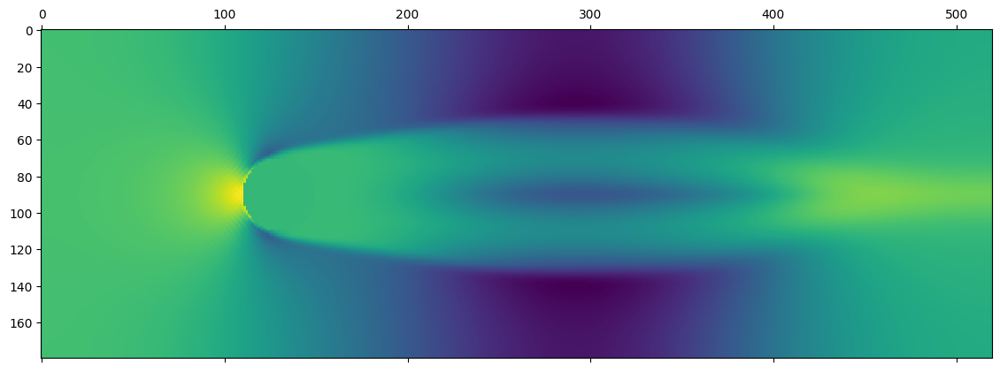

In [ ]:
plt.matshow(us[-1][0].T)

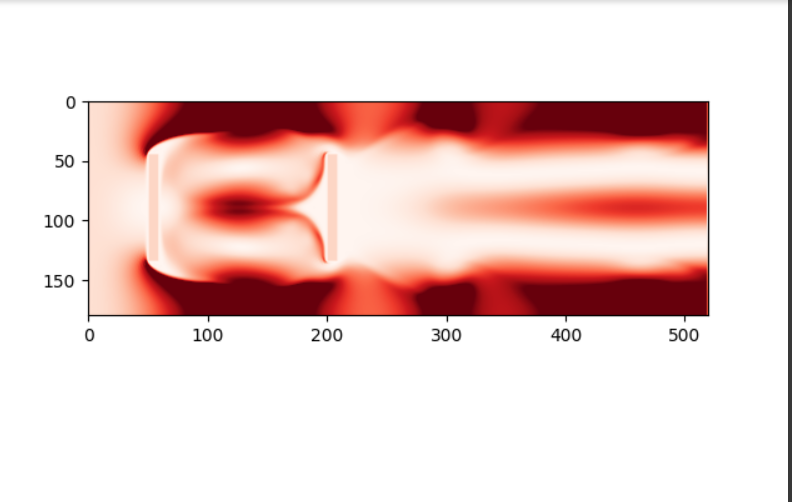

## Exercise 3: Something new... (EC)
*(Extra credit: 5 points)*


* **List of collaborators:**

* **References you used in developing your code:**

🦉Come up with something new and cool to do with this animation code.  Maybe try out some other interesting obstacles are add some friction to the walls or such.

#### Answer:

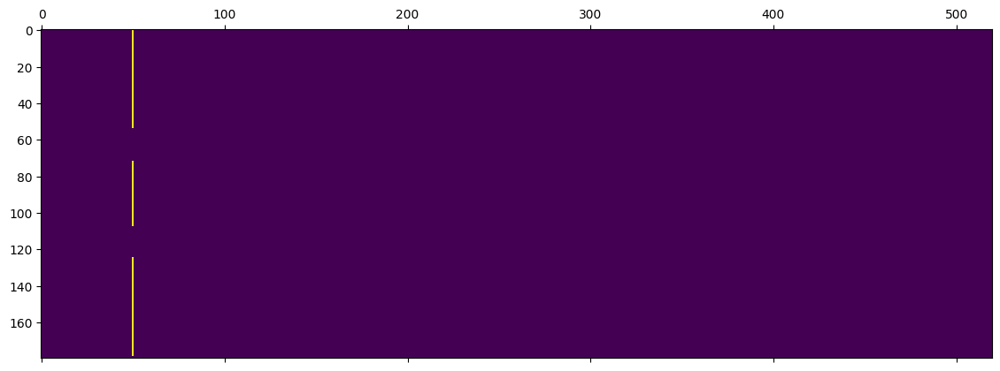

In [ ]:
def GenerateGrating():
  obstacle = np.zeros((nx,ny), dtype = 'bool')
  obstacle[:,:] = False
  obstacle[50: 51, : int(0.30* ny)] = True
  obstacle[50:51, int(0.40 * ny): int(0.60 * ny)] = True
  obstacle[50:51, int(0.70 * ny): -1] = True
  return obstacle
plt.matshow(GenerateGrating().T)

In [ ]:
obstacleGrating = GenerateGrating()

In [ ]:
fin_G= Setup()
feq_init_g=fin.copy()
fins_g=rhos_g=us_g= [None] * 21
fins_g[0] = fin_G.copy()
for i in range(0,20):
    print(i)
    %time rhos_g[i],us_g[i],fins_g[i+1]=Run(200,10,fins_g[i],feq_init_g,obstacleGrating)

0
CPU times: user 6.65 s, sys: 23.5 ms, total: 6.67 s
Wall time: 8.22 s
1
CPU times: user 5.5 s, sys: 15.1 ms, total: 5.52 s
Wall time: 5.52 s
2
CPU times: user 5.74 s, sys: 19.9 ms, total: 5.76 s
Wall time: 5.81 s
3
CPU times: user 5.44 s, sys: 15.9 ms, total: 5.46 s
Wall time: 5.47 s
4
CPU times: user 5.37 s, sys: 21.1 ms, total: 5.39 s
Wall time: 5.4 s
5
CPU times: user 5.72 s, sys: 11.8 ms, total: 5.73 s
Wall time: 5.77 s
6
CPU times: user 5.35 s, sys: 13.1 ms, total: 5.36 s
Wall time: 5.36 s
7
CPU times: user 5.84 s, sys: 14.9 ms, total: 5.86 s
Wall time: 5.91 s
8
CPU times: user 5.4 s, sys: 20 ms, total: 5.42 s
Wall time: 5.42 s
9
CPU times: user 5.82 s, sys: 17.8 ms, total: 5.84 s
Wall time: 5.89 s
10
CPU times: user 5.22 s, sys: 22 ms, total: 5.25 s
Wall time: 5.25 s
11
CPU times: user 5.31 s, sys: 22 ms, total: 5.33 s
Wall time: 5.34 s
12
CPU times: user 5.61 s, sys: 20.9 ms, total: 5.63 s
Wall time: 5.68 s
13
CPU times: user 5.37 s, sys: 18 ms, total: 5.39 s
Wall time: 5.39 s

In [ ]:
#!Start
us_flat_g = list(itertools.chain.from_iterable(us_g[0:-1]))
#us_flat = list(itertools.chain.from_iterable(us[0:17]))
anim=AnimateMe(us_flat_g,0.01)
fluidSimulationG = HTML(anim.to_jshtml())
with open('fluid_sim_grating.html','w') as f:
  f.write(fluidSimulationG.data)
fluidSimulationG
#!Stop

In [ ]:
nx, ny = 520, 180

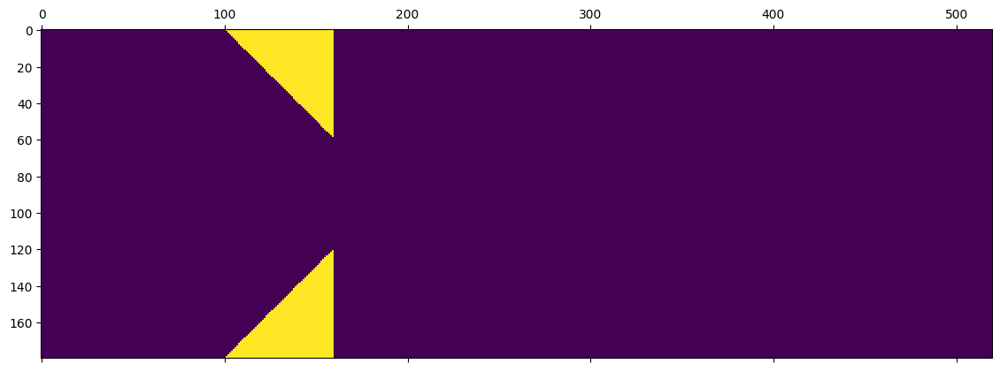

In [ ]:
def ObstacleFunnel():
  obstacle = np.zeros((nx, ny), dtype = 'bool')
  pos1 = 100
  for y in range(0, 60):
    obstacle[pos1 + y, :y] = True
    obstacle[pos1 + y, ny-y: ny] = True
  return obstacle

plt.matshow(ObstacleFunnel().T)

In [ ]:
fin_F= Setup()
feq_init_f=fin_F.copy()
fins_f = rhos_f = us_f = [None] * 21
fins_f[0] = fin_F.copy()
for i in range(0,20):
    print(i)
    %time rhos_f[i],us_f[i],fins_f[i+1]=Run(200,10,fins_f[i],feq_init_f,ObstacleFunnel())

0
CPU times: user 5.3 s, sys: 653 ms, total: 5.95 s
Wall time: 5.95 s
1
CPU times: user 5.76 s, sys: 747 ms, total: 6.51 s
Wall time: 6.58 s
2
CPU times: user 5.28 s, sys: 655 ms, total: 5.93 s
Wall time: 5.92 s
3
CPU times: user 5.51 s, sys: 682 ms, total: 6.2 s
Wall time: 6.25 s
4
CPU times: user 5.24 s, sys: 576 ms, total: 5.82 s
Wall time: 5.82 s
5
CPU times: user 5.4 s, sys: 688 ms, total: 6.09 s
Wall time: 6.12 s
6
CPU times: user 5.38 s, sys: 629 ms, total: 6.01 s
Wall time: 6.03 s
7
CPU times: user 5.42 s, sys: 604 ms, total: 6.02 s
Wall time: 6.04 s
8
CPU times: user 5.98 s, sys: 569 ms, total: 6.55 s
Wall time: 6.64 s
9
CPU times: user 5.5 s, sys: 642 ms, total: 6.14 s
Wall time: 6.15 s
10
CPU times: user 5.61 s, sys: 561 ms, total: 6.17 s
Wall time: 6.22 s
11
CPU times: user 5.47 s, sys: 767 ms, total: 6.24 s
Wall time: 6.29 s
12
CPU times: user 5.89 s, sys: 651 ms, total: 6.54 s
Wall time: 6.7 s
13
CPU times: user 6.32 s, sys: 593 ms, total: 6.92 s
Wall time: 8.47 s
14
CPU 

In [ ]:
us_flat_f = list(itertools.chain.from_iterable(us_f[0:-1]))
#us_flat = list(itertools.chain.from_iterable(us[0:17]))
anim=AnimateMe(us_flat_f,0.01)
fluidSimulationF = HTML(anim.to_jshtml())
with open('fluid_sim_grating.html','w') as f:
  f.write(fluidSimulationF.data)
fluidSimulationF

**Acknowledgement:** This assignment originally inspired from code from flowkit.com
* Bryan Clark (original)


Copyright: 2021

---

In [ ]:
!jupyter nbconvert --to html FluidDynamics.ipynb

[NbConvertApp] Converting notebook FluidDynamics.ipynb to html
[NbConvertApp] Writing 100669120 bytes to FluidDynamics.html
